[Данные](https://yadi.sk/d/CBoVCVIxJ2q2cw)

# Обработка лидарных данных
## Сегментация

### Про лидар

![](https://realnoevremya.com/uploads/gallery/b9/7e/35d10da899958110.jpg)

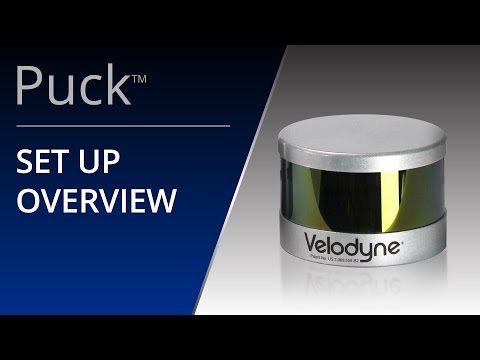

In [1]:
from IPython.lib.display import YouTubeVideo
YouTubeVideo('Pa-q5elS_nE')

## А что за данные на самом деле


In [2]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

import plotly.offline as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
import tqdm

EQUAL_ASPECT_RATIO_LAYOUT = dict(
    margin={
        'l': 0,
        'r': 0,
        'b': 0,
        't': 0
    }, scene=dict(
    aspectmode='data'
))


def color(x, cmap='Reds'):
    cmap = plt.get_cmap(cmap)
    x = (x - np.min(x)) / np.max(x)
    
    return cmap(x)

%matplotlib inline

D:\Users\argen\Anaconda3\lib\site-packages\dask\config.py:129: YAMLLoadWarning:

calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.



In [3]:
ds = pd.read_csv('./snow.csv')
ds = ds.set_index(['scene_id'])
ds.head()

,x,y,z,intensity,ring,label
scene_id,,,,,,
0,-11.355618,-4.206962,0.344085,0.0,23.0,1.0
0,-5.916535,-1.972164,0.283262,0.0,25.0,1.0
0,-7.410451,-2.113039,2.137792,0.0,31.0,1.0
0,-13.845870,-1.406652,0.406310,0.0,23.0,1.0
0,-8.326218,-0.346060,0.226469,0.0,22.0,1.0


* intensity - ???
* ring - ???

### Кольцо

![](https://eckop.com/wp-content/uploads/2018/07/LIDAR_02-1024x366.png)

In [4]:
scene = ds.loc[0]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.ring, 'tab20'),
    },
    'text': scene.ring
})

py.iplot(fig)

### Интенсивность

![](https://res.mdpi.com/sensors/sensors-15-28099/article_deploy/html/images/sensors-15-28099-g001-1024.png)

In [5]:
fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.intensity, 'seismic'),
    },
    'text': scene.intensity
})

py.iplot(fig)

In [6]:
scene = ds.loc[1]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.intensity, 'seismic'),
    },
    'text': scene.ring
})

py.iplot(fig)


# Отфильтруем снег

## Эвристикой

In [7]:
positive_intensity = [i for i, l in zip(scene.intensity, scene.label) if l == 0]
negative_intensity = [i for i, l in zip(scene.intensity, scene.label) if l == 1]

print(np.mean(positive_intensity), np.std(positive_intensity))
print(np.mean(negative_intensity), np.std(negative_intensity))
border = 2.0
tp = np.sum([(1 if i < border else 0) for i, l in zip(scene.intensity, scene.label) if l == 1])
fp = np.sum([(1 if i < border else 0) for i, l in zip(scene.intensity, scene.label) if l == 0])
fn = np.sum([(1 if i > border else 0) for i, l in zip(scene.intensity, scene.label) if l == 1])
precision = tp / (tp + fp)
recall = tp / (tp + fn)
print(precision, recall)

20.219012667219133 14.624020711032783
0.659963436928702 1.0589738970767666
0.8996212121212122 0.9430840502978161


In [8]:
def filter_by_intensity(intensity, limit=3.0):
    return [i for i, x in enumerate(intensity) if x > limit]

filtered_scene = scene.iloc[filter_by_intensity(scene.intensity), :]


fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': filtered_scene.x,
    'y': filtered_scene.y,
    'z': filtered_scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(filtered_scene.intensity, 'seismic'),
    },
    'text': scene.ring
})

py.iplot(fig)

Плохо и непонятно, будем учить

## Облачные вычисления

In [ ]:
from sklearn.neighbors import KDTree

class ComputeFeatures(object):
    def __init__(self, r=1.0):
        self.xyz = None
        self.intensity = None
        self.ring = None
        self.index = None
        self.r = r

    def _feature_names(self):
        return [
            "Neighbours count",
            "Intensity",
            "XY Distance",
            "Z",
            "Mean of neighbours distance",
            "Std of neighbours distance",
            "Min of neighbours distance",
            "Mean of neighbours xy distance",
            "Std of neighbours xy distance",
            "Min of neighbours xy distance",
            "Count of neoghbours with intensity > 3",
            "Mean of neighbours intensity",
            "Std of neighbours intensity",
            "Neighbours count on the same ring",
            "Neighbours percentage on the same ring"   
        ]

        
    def compute_point_features(self, point_id, neighbours):
        features = []
        features.append(len(neighbours))
        features.append(self.intensity[point_id])
        features.append(np.linalg.norm(self.xyz[point_id][:2]))
        features.append(self.xyz[point_id][2])
        distance_to_neighbours = [np.linalg.norm(self.xyz[i] - self.xyz[point_id]) 
                                  for i in neighbours if i != point_id]
        xy_dist_to_neighbours = [np.linalg.norm(self.xyz[i][:2] - self.xyz[point_id][:2]) 
                                 for i in neighbours if i != point_id]
        features.append(np.mean(distance_to_neighbours) if len(neighbours) > 1 else self.r)
        features.append(np.std(distance_to_neighbours) if len(neighbours) > 1 else 0.0)
        features.append(np.min(distance_to_neighbours) if len(neighbours) > 1 else self.r)
        features.append(np.mean(xy_dist_to_neighbours) if len(neighbours) > 1 else self.r)
        features.append(np.std(xy_dist_to_neighbours) if len(neighbours) > 1 else 0.0)
        features.append(np.min(xy_dist_to_neighbours) if len(neighbours) > 1 else self.r)
        neighbours_intensity = [self.intensity[i] for i in neighbours if i != point_id]
        features.append(len([i for i in neighbours_intensity if i > 3.0]) / len(neighbours))
        features.append(np.mean(neighbours_intensity)if len(neighbours) > 1 else 0)
        features.append(np.std(neighbours_intensity) if len(neighbours) > 1 else 0)
        count_of_same_ring = len([i for i in neighbours if self.ring[i] == self.ring[point_id] and i != point_id])
        features.append(count_of_same_ring)
        features.append(count_of_same_ring / len(neighbours))
        return features
    
    def get_point_neighbours(self, point_id):
        return self.index.query_radius(self.xyz[point_id][np.newaxis, :], r=self.r)[0]
        
    def __call__(self, xyz, intensity, ring):
        self.xyz = xyz[:]
        self.intensity = intensity[:]
        self.ring = ring[:]
        
        self.index = KDTree(self.xyz)
        
        features = []
        for point_id in range(len(self.xyz)):
            neighbours = self.get_point_neighbours(point_id)
            features.append(self.compute_point_features(point_id, neighbours))
        
        
        return pd.DataFrame(columns=self._feature_names(), data=features)
    


In [ ]:
# ds_features = pd.read_csv('./snow_features.csv')
# ds_features = ds_features.drop(["Unnamed: 0"], axis=1)
# ds_features.shape

In [ ]:
workers = 4
from joblib import Parallel, delayed

R = 1.0

def process_scene(scene_id, scene, r):
    features = ComputeFeatures(r=r)
    features_df = \
        features(scene[['x', 'y', 'z']].values, scene.intensity.values, scene.ring.values)
    features_df.to_csv(f'./features/{scene_id}.csv')

with Parallel(workers) as pool:
    pool(
        delayed(process_scene)(scene_id, scene=ds.loc[scene_id], r=R)
        for scene_id in tqdm.tqdm(ds.reset_index().scene_id.unique())
    )

# Посмотрим на разметку

In [9]:
scene = ds.loc[1]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.label, 'seismic'),
    },
    'text': scene.label
})

py.iplot(fig)

## Поучим что-нибудь

In [10]:
data = [(i, pd.read_csv(f'./features/{i}.csv')) for i in ds.reset_index().scene_id.unique()]
#for i, d in data:
#    d["scene_id"] = i
features = pd.concat([d for _, d in data]).drop("Unnamed: 0", axis=1)

In [11]:
ds_ = ds.reset_index()
df_ = features.reset_index(drop=True)
df = pd.concat([df_, ds_], axis=1)

In [12]:
df

,Neighbours count,Intensity,XY Distance,Z,Mean of neighbours distance,Std of neighbours distance,Min of neighbours distance,Mean of neighbours xy distance,Std of neighbours xy distance,Min of neighbours xy distance,...,Std of neighbours intensity,Neighbours count on the same ring,Neighbours percentage on the same ring,scene_id,x,y,z,intensity,ring,label
0,1,0.0,12.109855,0.344085,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000,...,0.000000,0,0.000000,0,-11.355618,-4.206962,0.344085,0.0,23.0,1.0
1,1,0.0,6.236571,0.283262,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000,...,0.000000,0,0.000000,0,-5.916535,-1.972164,0.283262,0.0,25.0,1.0
2,1,0.0,7.705824,2.137792,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000,...,0.000000,0,0.000000,0,-7.410451,-2.113039,2.137792,0.0,31.0,1.0
3,1,0.0,13.917140,0.406310,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000,...,0.000000,0,0.000000,0,-13.845870,-1.406652,0.406310,0.0,23.0,1.0
4,1,0.0,8.333406,0.226469,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000,...,0.000000,0,0.000000,0,-8.326218,-0.346060,0.226469,0.0,22.0,1.0
5,1,7.0,29.098697,0.945424,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000,...,0.000000,0,0.000000,0,-29.016968,-2.179385,0.945424,7.0,24.0,1.0
6,3,2.0,2.074988,0.044024,0.450585,0.413329,0.037255,0.446005,0.410500,0.035504,...,9.000000,0,0.000000,0,-2.074985,0.003017,0.044024,2.0,16.0,1.0
7,3,3.0,2.041936,0.055311,0.439146,0.401891,0.037255,0.435190,0.399686,0.035504,...,9.500000,0,0.000000,0,-2.041912,-0.009894,0.055311,3.0,17.0,1.0
8,2,0.0,6.325543,0.086301,0.523315,0.000000,0.523315,0.472036,0.000000,0.472036,...,0.000000,0,0.000000,0,-6.275961,0.790447,0.086301,0.0,19.0,1.0
9,2,0.0,8.510698,0.044705,0.490771,0.000000,0.490771,0.420384,0.000000,0.420384,...,0.000000,0,0.000000,0,-8.290426,1.923754,0.044705,0.0,18.0,1.0


In [13]:
import random

validate_ratio = 0.1
test_ratio = 0.1

unique_scenes = list(df.scene_id.unique())
random.shuffle(unique_scenes)
validate_scenes = int(validate_ratio * len(unique_scenes))
test_scenes = int(test_ratio * len(unique_scenes))

train_scenes = set(unique_scenes[test_scenes + validate_scenes:])
test_scenes = set(unique_scenes[validate_scenes:test_scenes+validate_scenes])
validate_scenes = set(unique_scenes[:validate_scenes])

In [14]:
train = df.loc[df.scene_id.isin(train_scenes)]
test = df.loc[df.scene_id.isin(test_scenes)]
val = df.loc[df.scene_id.isin(validate_scenes)]

In [15]:
import catboost

def learn(X_train, X_val, y_train, y_val):
    clf = catboost.CatBoostClassifier(n_estimators=100)
    clf.fit(
        X_train, y_train, early_stopping_rounds=10,
        use_best_model=True, eval_set=(X_val.values, y_val.values), plot=True, verbose=False)
    return clf

X_train = train.drop(["scene_id", "label", "x", "y", "z", "intensity", "ring"], axis=1)
y_train = train.label


X_val = val.drop(["scene_id", "label", "x", "y", "z", "intensity", "ring"], axis=1)
y_val = val.label

In [16]:
del ds
cls = learn(X_train, X_val, y_train, y_val)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [31]:
X_test = test.drop(['scene_id', 'x', 'y', 'z', 'label'], axis=1)
y_test = test.label

from sklearn.metrics import precision_recall_curve, precision_score, recall_score

def test_one(clf, X_test, y_test):
    y_test_hat = clf.predict_proba(X_test)
    pr, rec, thr = precision_recall_curve(y_test, y_test_hat[:, 1])
    ix = np.linspace(1, len(pr)-1, num=2000).astype(int)
    return pr[ix], rec[ix], thr[ix - 1]


def heuristic_filter_scoring():
    pr = []
    rec = []
    filter_range = range(0, 10)
    for i in filter_range:
        y_test_heuristic_hat = np.ones(len(X_test))
        y_test_heuristic_hat[filter_by_intensity(test.intensity, i)] = 0
        pr.append(precision_score(y_test, y_test_heuristic_hat))
        rec.append(recall_score(y_test, y_test_heuristic_hat))
        
    return pr, rec, filter_range

pr_bl, rec_bl, thr_bl = heuristic_filter_scoring()

def plot_pr_rec(*models):
    traces = []
    for model, clf, X_test, y_test in models:
        pr, rec, thr = test_one(clf, X_test, y_test)
        pr_rec = go.Scattergl(x = rec, y = pr, mode='lines', text=str(thr), name=model)
        traces.append(pr_rec)

    pr_rec_bl = go.Scatter(x = rec_bl, y = pr_bl, mode='lines+markers', text=str(thr_bl), name='Intensity BL')

    layout = go.Layout(
        title='Precission-recall',
        xaxis=dict(
            title='Recall'
        ),
        yaxis=dict(
            title='Precission'
        ))
    fig = go.Figure(
        data=traces + [pr_rec_bl],
        layout=layout)
    py.iplot(fig)
    
models = [('Catboost classifier', cls, X_test, y_test)]
plot_pr_rec(*models)

# Повизуализируем

In [18]:
y_test_hat = cls.predict_proba(test.drop(['scene_id', 'x', 'y', 'z', 'label', "intensity", "ring"], axis=1))

In [19]:
itest = test.set_index(['scene_id'])

In [20]:
print(test.scene_id.unique())
test_ids = test.scene_id.unique()

[ 19  29  32  78  79  81  93  96 127 133 161 166 167 175 180 192 204 206
 208 215 224 231 237 248 252 272 284 288 289]


In [21]:
#scene_id = 212 # Why is that :(
scene_id = test_ids[random.randint(0, len(test_ids) - 1)]
scene = itest.loc[scene_id]
scene_predictions = y_test_hat[test.scene_id == scene_id][:, 1]
scene_predictions = (scene_predictions > 0.5).astype(np.int)

In [22]:
scene_labels = np.array(scene.label).astype(np.int)

In [23]:
def custom_color(labels, predictions):
    c = []
    for l, p in zip(labels, predictions):
        color = (0.0, 0.0, 0.0)
        if l == 0 and p == 1: # classified as snow while a good point
            color = (0.8, 0.8, 0.0)
        if l == 1 and p == 0: # classified as a good point while it is a snow
            color = (0.8, 0.0, 0.0)
        if l == 0 and p == 0: # classified as a good point
            color = (0., 0., 0.8)
        if l == 1 and p == 1: # classified as a snow
            color = (0., 0., 0.)
        c.append(color)
    return c

def custom_texts(labels, predictions):
    return [f"L: {l}, P: {p}" for l, p in zip(labels, predictions)]

In [24]:
fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': custom_color(scene_labels, scene_predictions),
    },
    'text': custom_texts(scene_labels, scene_predictions)
})
py.iplot(fig)

In [38]:
from catboost import utils as cutils
metrics = ["F1", "R2", "Precision", "Recall"]
y_pred = (y_test_hat[:, 1] > 0.5).astype(np.int)
y_true = np.array(y_test).astype(np.int)

for m in metrics:
    print(f"{m}: {cutils.eval_metric(y_pred, y_true, m)[0]}")

F1: 0.9773241599941833
R2: 0.950555097797862
Precision: 0.9756128540581736
Recall: 0.9790414800247642


In [25]:
cls.get_feature_importance(prettified=True)

,Feature Id,Importances
0,XY Distance,19.836619
1,Neighbours count on the same ring,13.595360
2,Intensity,12.936208
3,Z,11.506746
4,Mean of neighbours intensity,6.187023
5,Neighbours count,6.092284
6,Count of neoghbours with intensity > 3,5.879666
7,Min of neighbours distance,5.091879
8,Mean of neighbours distance,5.000915
9,Neighbours percentage on the same ring,4.676162


### Немного анализа полученного результата
1. Поскольку одним из самых значимых признаков является количество соседей того же кольца, то в дальнейшем имеет смысл добавить больше признаков, которые добавляют информацию про соседей из данного кольца (например, минимальная, средняя и максимальная интенсивность)

2. Расстояние по плоскости и высота являются одними из самых значимых фичей, поскольку очевидно, что количество попаданий лидара в снежинки с расстоянием резко убывает. Кроме того, многие объекты зачастую находятся близко к земле, а снег чаще находится выше уровня земли

3. Как и ожидалось, интенсивность самой точки играет довольно важную роль в оценке ее шумности.